<a href="https://colab.research.google.com/github/Tung0000/Train_Custom_YoloV8_card/blob/main/Train_Custom_YoloV8_card.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#ติดตั้ง Library ที่จำเป็น

In [ ]:
!pip install ultralytics
!pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 63.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.7/88.7 kB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 84.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 134.1 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10


#โหลด Dataset จาก Roboflow

In [ ]:
#from google.colab import drive
#drive.mount('/content/drive')

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="0100tTC6iSisNdselYOb")
project = rf.workspace("augmented-startups").project("playing-cards-ow27d")
version = project.version(4)
dataset = version.download("yolov8")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Playing-Cards-4 in yolov8:: 100%|██████████| 48478/48478 [00:15<00:00, 3185.06it/s]


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


#  เช็คโดยใช้ ImageDataGenerator

In [ ]:
#import matplotlib.pyplot as plt

In [ ]:
#train_dir =
#test_dir =
#valid_dir =

In [ ]:
#import numpy as np
#import matplotlib.pyplot as plt
#from tensorflow.keras.preprocessing.image import ImageDataGenerator
#import tensorflow as tf

In [ ]:
##ImageDataGenerator()

In [ ]:
#datagen=ImageDataGenerator(rescale=1./255,zoom_range=0.2,brightness_range=[0.5,1.5], rotation_range=20,horizontal_flip=True)

#train_test=datagen.flow_from_directory(train_dir,target_size=(64,64),batch_size=32,class_mode='categorical')

In [ ]:
#datagen=ImageDataGenerator(rescale=1./255,zoom_range=0.2,brightness_range=[0.5,1.5], rotation_range=20,horizontal_flip=True)

#valid_test=datagen.flow_from_directory(valid_dir,target_size=(64,64),batch_size=32,class_mode='categorical')

In [ ]:
#x=train_test.samples
#y=train_test.class_indices
#z=train_test.num_classes
#a=train_test.batch_size
#print(x,y,z,a)

In [ ]:
#x=valid_test.samples
#y=valid_test.class_indices
#z=valid_test.num_classes
#a=valid_test.batch_size
#print(x,y,z,a)

In [ ]:
#plt.imshow(train_test[0][0][0])

In [ ]:
#train_test.class_indices

In [ ]:
#ids,counts= np.unique(train_test.classes, return_counts=True)
#print(f"มี class เท่ากับ {ids}")
#print(counts)

In [ ]:
#labels = (train_test.class_indices)
#labels = dict((v,k) for k,v in labels.items())
#labels

#for i in ids:
#    print('{:>6} = {}' . format(labels[i], counts[i]))

In [ ]:
#train_test[0][0][0].shape

In [ ]:
#valid_test[0][0][0].shape

#  Train Model Yolo ด้วย Dataset ที่เตรียมไว้

In [ ]:
from ultralytics import YOLO

# โหลดโมเดล
model = YOLO("yolov8s.pt")

# เทรนพร้อม custom augmentation
model.train(
    data="/content/Playing-Cards-4/data.yaml",
    epochs=30,
    imgsz=640,
    augment=True,  # เปิดใช้ augmentation
    degrees=20,    # หมุน
    scale=0.5,     # random scale
    flipud=0.3,    # flip vertical
    fliplr=0.5,    # flip horizontal
    hsv_h=0.015,   # ปรับ hue
    hsv_s=0.7,     # ปรับ saturation
    hsv_v=0.4      # ปรับ brightness
)


Ultralytics 8.3.203 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Playing-Cards-4/data.yaml, degrees=20, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.3, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, po

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x798857652ea0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.03303

#โหลด model แบบบลดขนาด

In [ ]:
from ultralytics import YOLO

# โหลดโมเดลที่ train เสร็จ
model = YOLO("/content/runs/detect/train/weights/best.pt")

# Export เป็น ONNX
model.export(format="onnx", opset=12)

# Export เป็น TFLite แบบ quantized INT8
model.export(format="tflite", int8=True)

Ultralytics 8.3.203 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.00GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel hardware. Learn more at https://docs.ultralytics.com/integrations/openvino/
Model summary (fused): 72 layers, 11,145,708 parameters, 0 gradients, 28.5 GFLOPs

PyTorch: starting from '/content/runs/detect/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 56, 8400) (21.5 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0', 'onnxslim>=0.1.67', 'onnxruntime-gpu'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 6.0s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.19.1rc1 opset 12...
ONNX: slimming with onnxslim 0.1.69...
ONNX: export success ✅ 8.0s, saved as '/content/runs/detect/train/weights/best.onnx' (42.7 MB)

Export complete (9.0s)
Results saved to /content/runs/detect/train/weights
Predict:       

'/content/runs/detect/train/weights/best_saved_model/best_int8.tflite'

#เช็ต parameters

In [ ]:
from ultralytics import YOLO

model = YOLO("/content/runs/detect/train/weights/best.pt")
total_params = sum(p.numel() for p in model.model.parameters())
print(f"Total parameters: {total_params/1e6:.2f} M")

Total parameters: 11.16 M


#แสดงผลลัพธ์จากการ Train Model





##แสดง Confusion Metrix

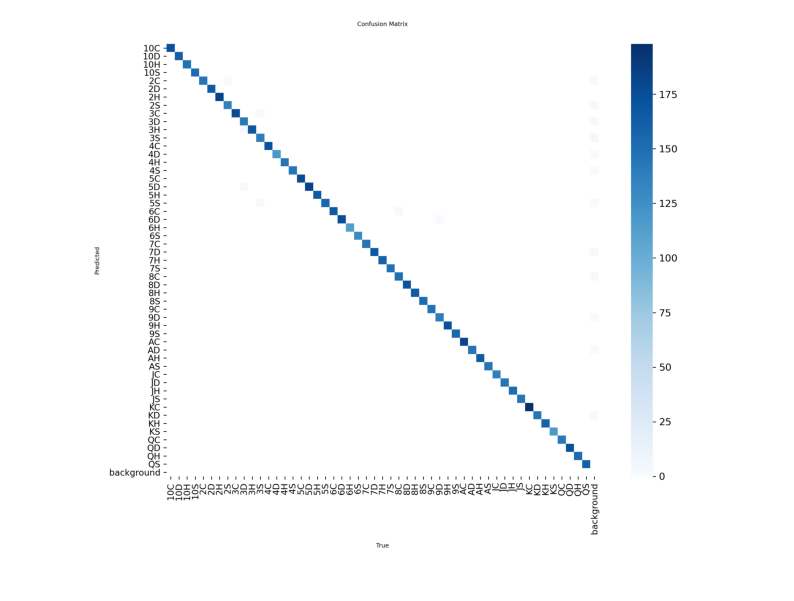

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img=mpimg.imread('/content/runs/detect/train/confusion_matrix.png')
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.axis("off")
plt.show()

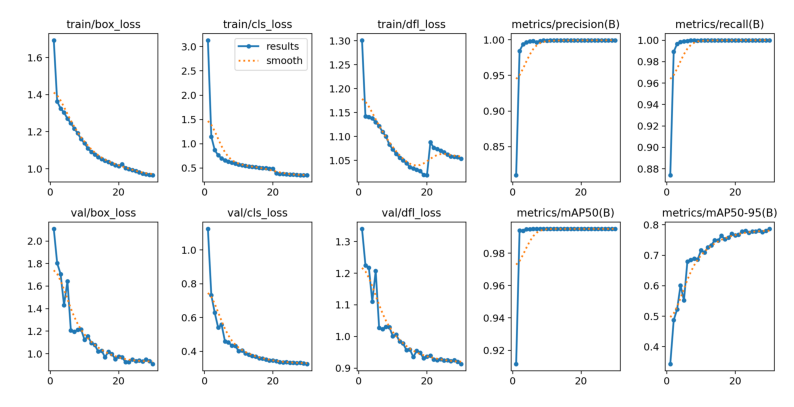

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img = mpimg.imread('/content/runs/detect/train/results.png')
plt.figure(figsize=(10, 10))
plt.imshow(img)
plt.axis("off")
plt.show()

##แสดงภาพตัวอย่างที่ทำนายแล้ว จากการ Valid

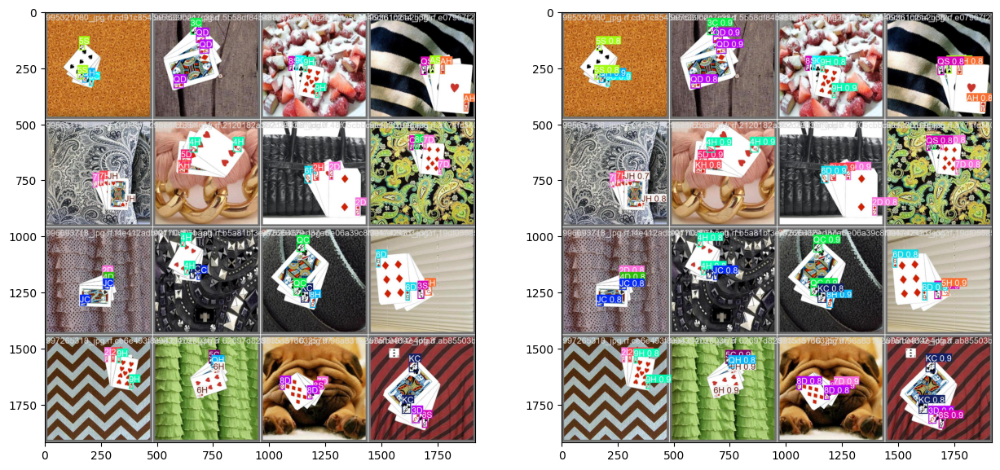

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# โหลดรูป
img_left = mpimg.imread('/content/runs/detect/train/val_batch0_labels.jpg')
img_right = mpimg.imread('/content/runs/detect/train/val_batch0_pred.jpg')

plt.figure(figsize=(15, 15))  # กำหนดขนาดรวม

# รูปซ้าย (index=1)
plt.subplot(1, 2, 1)
plt.imshow(img_left)
plt.axis("on")

# รูปขวา (index=2)
plt.subplot(1, 2, 2)
plt.imshow(img_right)
plt.axis("on")

plt.show()

#ดาวน์โหลด Model ไปใช้

In [ ]:
from google.colab import files
# ระบุเส้นทางของไฟล์ที่ต้องการดาวน์โหลด
file_path ='/content/runs/detect/train2/weights/best.pt'
# ดาวน์โหลดไฟล์
files.download(file_path)

# การนำโมเดลที่สำเร็จแล้วมาใช้ (ใน Colab)

In [ ]:
import cv2
from ultralytics import YOLO
import matplotlib.pyplot as plt
from google.colab import files
import os

## อัพโหลดไฟล์รูปที่ต้องการค้นหาวัตถุ

In [ ]:
uploaded = files.upload("")  # เรียกใช้ตัวอัพโหลดรูปของ Colab
if not uploaded:
    raise FileNotFoundError("No file uploaded!")
test_image_path = next(iter(uploaded.keys()))  # เก็บชื่อไฟล์เข้าสู่ตัวแปร

NameError: name 'files' is not defined

## เรียกใช้โมเดลที่ Train ไว้แล้ว

In [ ]:
# โหลดโมเดล best
model_path = '/content/runs/detect/train/weights/best.pt'
if not os.path.exists(model_path):
    raise FileNotFoundError(f"YOLO model file not found at {model_path}")
model = YOLO(model_path)

## อ่านภาพที่อัพโหลดผ่าน Model

In [ ]:
# โหลดภาพด้วย OpenCV
image = cv2.imread("/content/AcetoFive.JPG")
if image is None:
    raise FileNotFoundError(f"Image not found at {test_image_path}")

# แปลงรูปสีเป็นขาวดำ
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# ส่งภาพเข้าโมเดล
results = model(image)


0: 480x640 1 3S, 3 5Cs, 1 AS, 1 KS, 48.6ms
Speed: 3.6ms preprocess, 48.6ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


## ตีกรอบ (Bounding Box) วัตถุจากผลลัพธ์ของ Model

In [ ]:
for result in results:
    boxes = result.boxes.cpu().numpy()  # แปลงตำแหน่ง Bounding Box ให้อยู่ในรูปแบบ NumPy array
    for box in boxes:
        x1, y1, x2, y2 = box.xyxy[0]  # ดึงค่าพิกัด Bounding Box (มุมซ้ายบนและมุมขวาล่าง)
        confidence = box.conf[0]  # ดึงค่าความเชื่อมั่นวัตถุ
        cls = int(box.cls[0])  # ดึงค่า class id ของวัตถุที่ตรวจจับได้
        if confidence > 0.5:  # กรองเฉพาะวัตถุที่มีเชื่อมั่นมากกว่า 50%
            label = f"{model.names[cls]} {confidence:.2f}"  # สร้างข้อความแสดงชนิดของวัตถุและค่าความเชื่อมั่น
            # ตีกรอบ (สีแดงและความหนา 3 พิกเซล)
            cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 3)
            # เขียนข้อความ label
            cv2.putText(image,label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

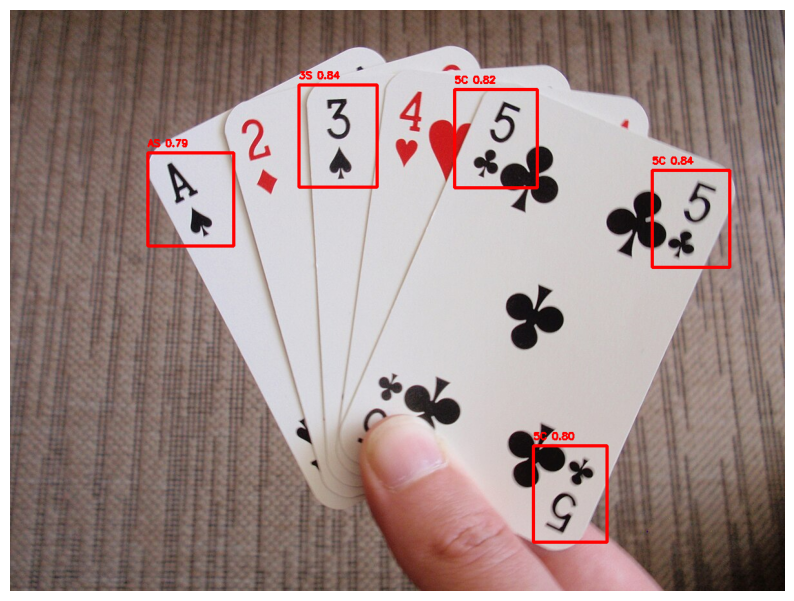

In [ ]:
# Display the resulting image using matplotlib
plt.figure(figsize=(10, 10))
plt.imshow(image)
plt.axis("off")
plt.show()

#ลองแบบวิดิโอ

🎥 ตรวจพบว่าเป็นวิดีโอ

0: 384x640 (no detections), 11.2ms
Speed: 3.1ms preprocess, 11.2ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


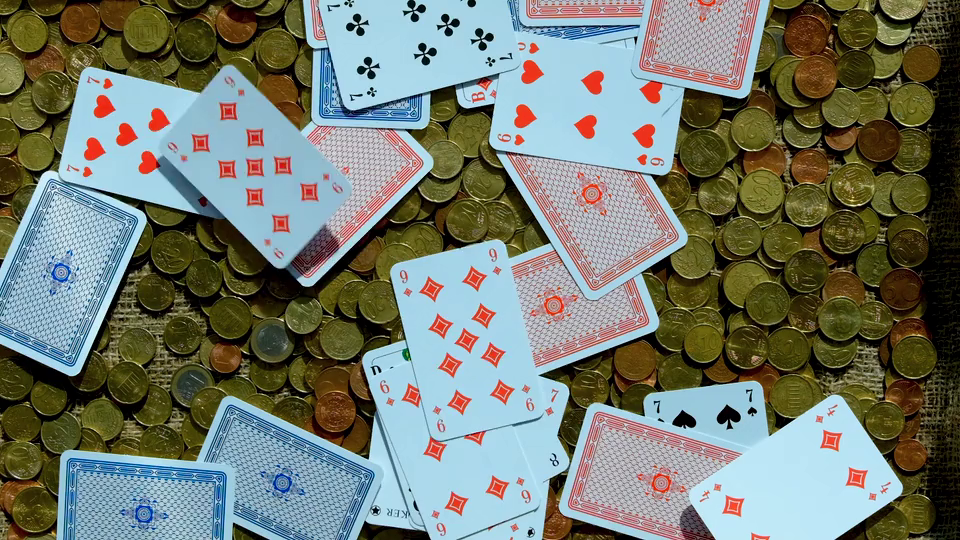


0: 384x640 (no detections), 11.0ms
Speed: 3.4ms preprocess, 11.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 10.8ms
Speed: 3.1ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 3C, 10.8ms
Speed: 2.9ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 7Cs, 12.4ms
Speed: 2.9ms preprocess, 12.4ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 7Cs, 13.5ms
Speed: 4.2ms preprocess, 13.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 13.1ms
Speed: 2.8ms preprocess, 13.1ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 10.8ms
Speed: 4.0ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 2 7Cs, 10.8ms
Speed: 3.1ms preprocess, 10.8ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 

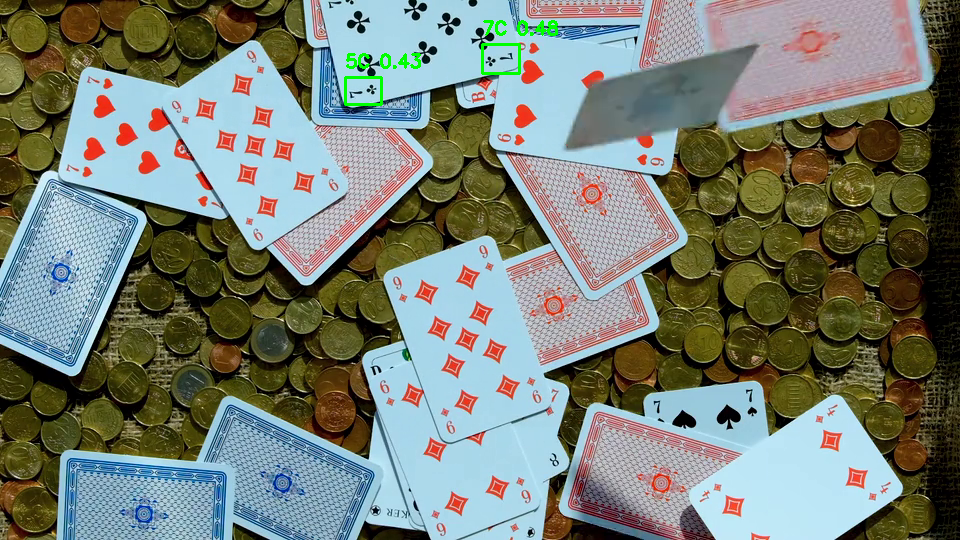


0: 384x640 1 5C, 1 7C, 10.6ms
Speed: 3.1ms preprocess, 10.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 1 7C, 12.3ms
Speed: 3.2ms preprocess, 12.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 1 7C, 10.5ms
Speed: 5.1ms preprocess, 10.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 1 7C, 1 7S, 10.9ms
Speed: 2.9ms preprocess, 10.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 1 7C, 10.6ms
Speed: 4.8ms preprocess, 10.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 1 7C, 10.6ms
Speed: 2.8ms preprocess, 10.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 1 5C, 1 7C, 10.6ms
Speed: 2.8ms preprocess, 10.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 1 5C, 1 7C, 15.8ms
Speed: 3.4ms preprocess, 15.8ms inference, 3.7ms postpr

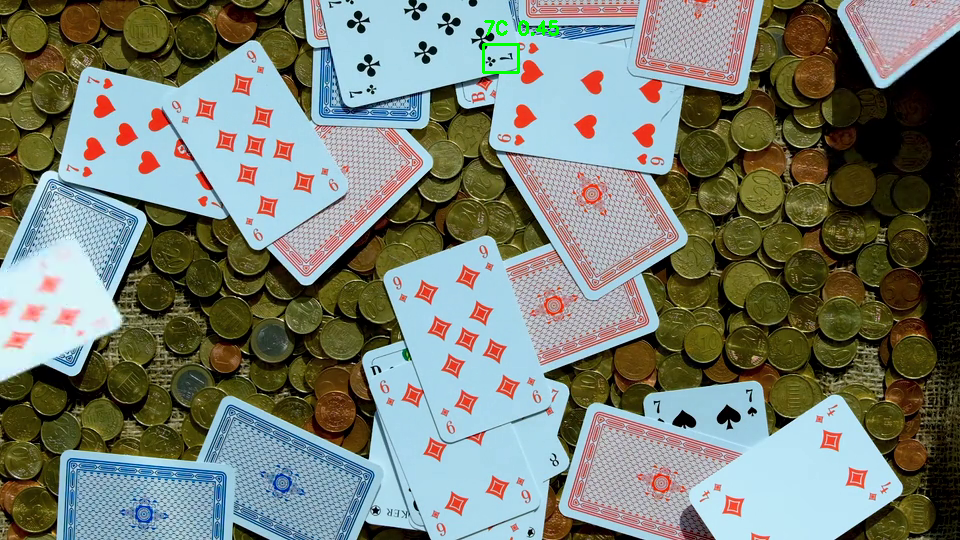


0: 384x640 1 7C, 10.6ms
Speed: 4.4ms preprocess, 10.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 13.5ms
Speed: 3.1ms preprocess, 13.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 2 7Cs, 10.5ms
Speed: 5.0ms preprocess, 10.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 2 7Cs, 10.6ms
Speed: 4.1ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 2 7Cs, 11.4ms
Speed: 4.5ms preprocess, 11.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 2 7Cs, 10.6ms
Speed: 4.0ms preprocess, 10.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 5C, 2 7Cs, 17.7ms
Speed: 4.7ms preprocess, 17.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 12.6ms
Speed: 2.7ms preprocess, 12.6ms inference, 1.4ms postprocess per image at shape (1, 3,

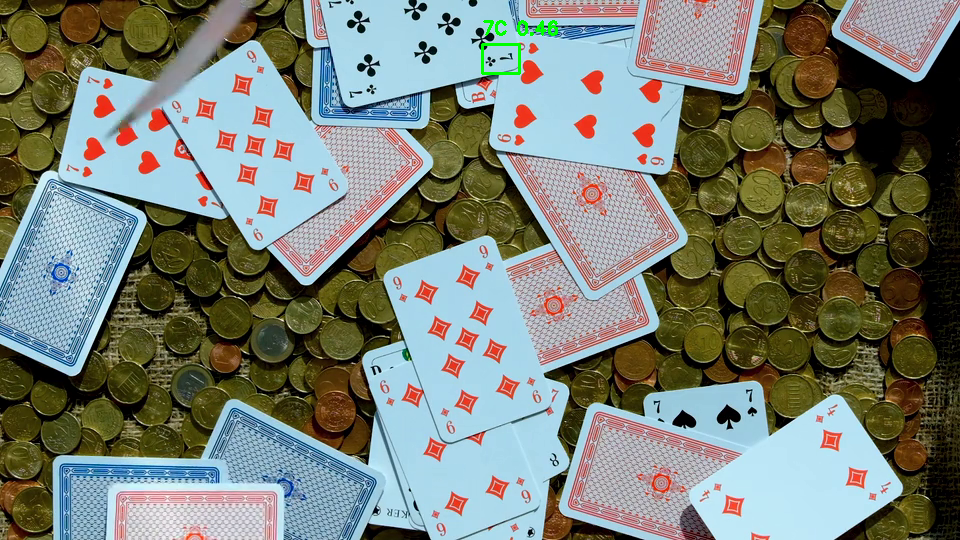


0: 384x640 1 7C, 10.9ms
Speed: 3.3ms preprocess, 10.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 10.8ms
Speed: 2.8ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 3C, 1 7C, 10.8ms
Speed: 2.5ms preprocess, 10.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.8ms
Speed: 5.1ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 10.8ms
Speed: 2.9ms preprocess, 10.8ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.1ms
Speed: 4.3ms preprocess, 11.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.8ms
Speed: 2.7ms preprocess, 10.8ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.9ms
Speed: 3.0ms preprocess, 10.9ms inference, 0.7ms postprocess per image 

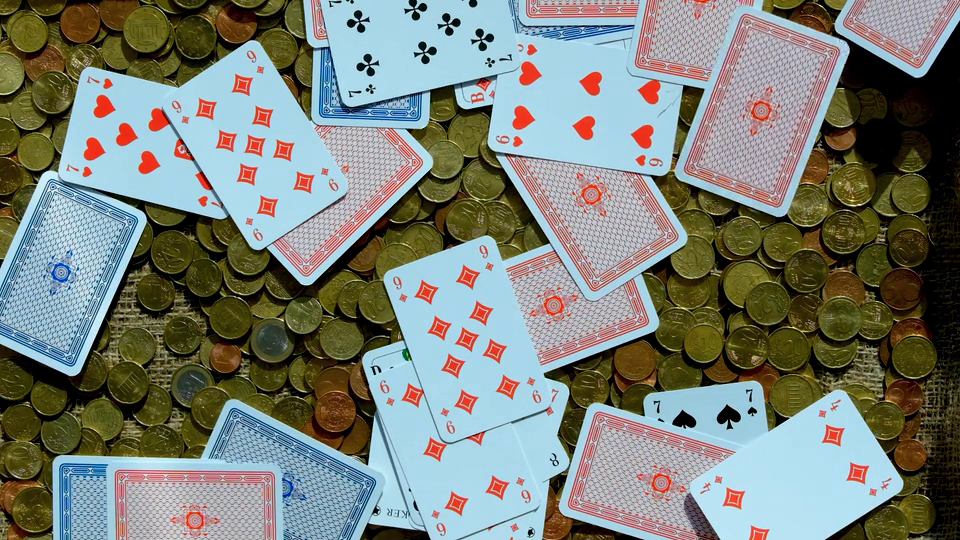


0: 384x640 (no detections), 10.9ms
Speed: 3.6ms preprocess, 10.9ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.0ms
Speed: 3.5ms preprocess, 11.0ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 10.8ms
Speed: 2.7ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 10.8ms
Speed: 5.4ms preprocess, 10.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 10.7ms
Speed: 2.6ms preprocess, 10.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 10.8ms
Speed: 4.8ms preprocess, 10.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.8ms
Speed: 2.7ms preprocess, 10.8ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.2ms
Speed: 4.9ms preprocess, 11.2ms inference, 0.7ms postprocess per image at sha

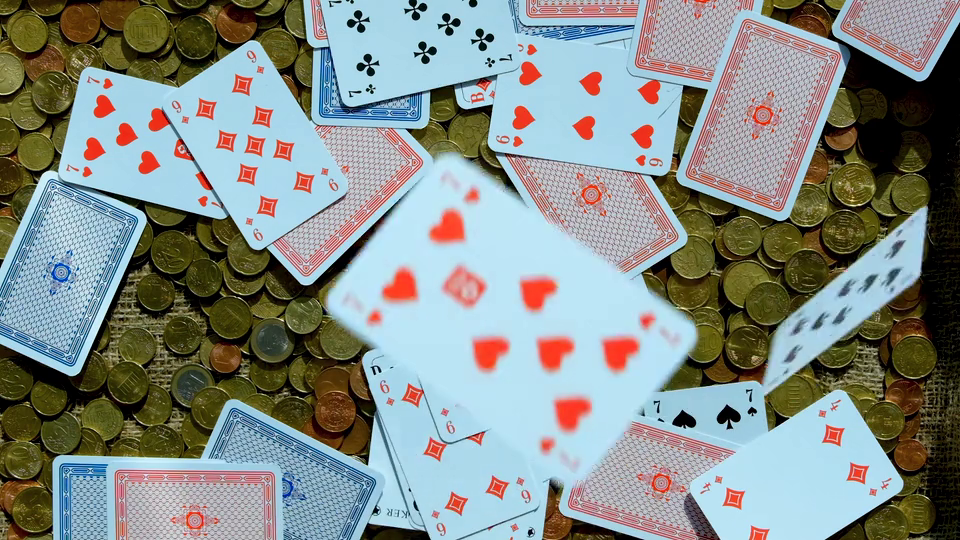


0: 384x640 1 4S, 10.6ms
Speed: 5.6ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 14.2ms
Speed: 3.6ms preprocess, 14.2ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.6ms
Speed: 5.6ms preprocess, 11.6ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 12.5ms
Speed: 3.3ms preprocess, 12.5ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.4ms
Speed: 2.8ms preprocess, 10.4ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.3ms
Speed: 3.2ms preprocess, 10.3ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 10.3ms
Speed: 2.6ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.4ms
Speed: 3.1ms preprocess, 10.4ms inference, 0.7ms postprocess per i

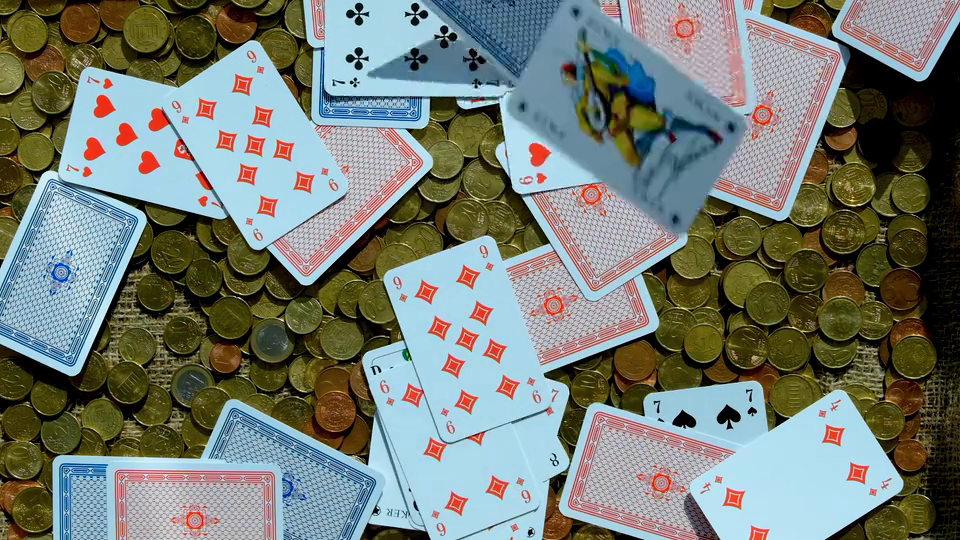


0: 384x640 (no detections), 13.3ms
Speed: 5.5ms preprocess, 13.3ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 17.4ms
Speed: 5.9ms preprocess, 17.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 1 7C, 12.1ms
Speed: 5.5ms preprocess, 12.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 19.0ms
Speed: 5.9ms preprocess, 19.0ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 15.5ms
Speed: 5.1ms preprocess, 15.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 11.6ms
Speed: 5.2ms preprocess, 11.6ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 4S, 1 7C, 14.7ms
Speed: 3.0ms preprocess, 14.7ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 15.3ms
Speed: 3.9ms preprocess, 15.3ms inference, 1.5ms postprocess per image at shape (1, 3, 

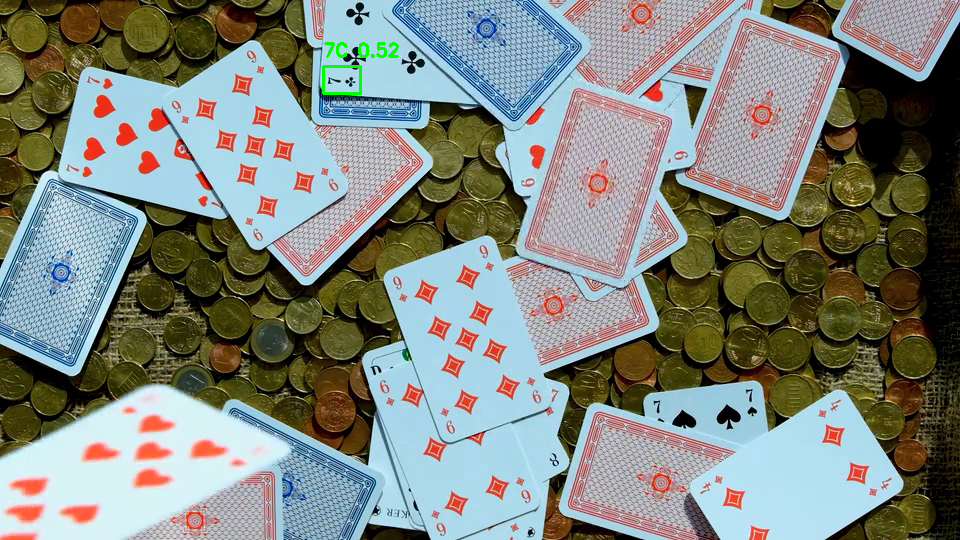


0: 384x640 1 7C, 10.1ms
Speed: 3.3ms preprocess, 10.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 10.0ms
Speed: 2.7ms preprocess, 10.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 10.2ms
Speed: 2.8ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 16.9ms
Speed: 5.7ms preprocess, 16.9ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 15.4ms
Speed: 5.3ms preprocess, 15.4ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 7C, 15.7ms
Speed: 5.4ms preprocess, 15.7ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 14.6ms
Speed: 4.8ms preprocess, 14.6ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.4ms
Speed: 5.2ms preprocess, 11.4ms inference, 0.8ms postprocess per image at shape (1, 3, 3

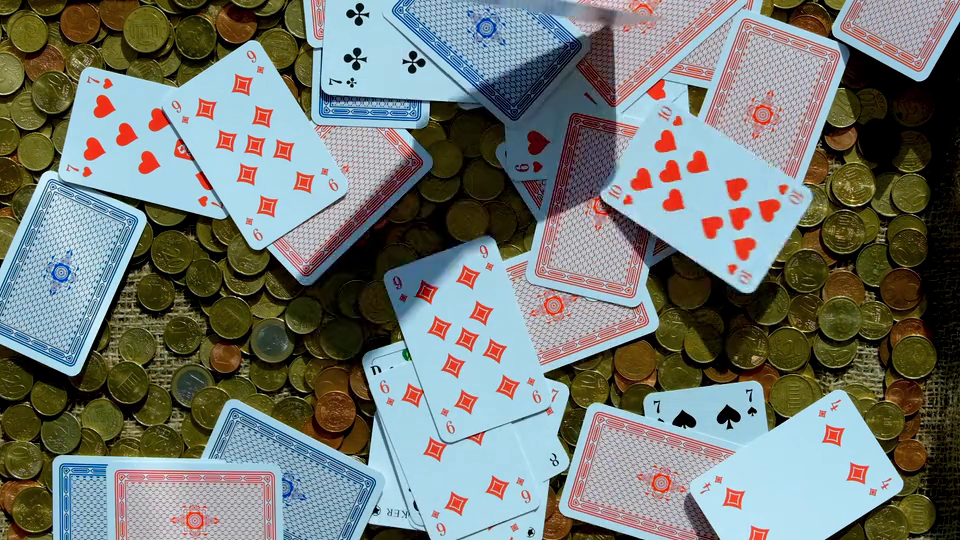


0: 384x640 (no detections), 12.5ms
Speed: 4.2ms preprocess, 12.5ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.8ms
Speed: 3.3ms preprocess, 11.8ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.7ms
Speed: 2.8ms preprocess, 11.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.3ms
Speed: 3.6ms preprocess, 11.3ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 12.3ms
Speed: 4.9ms preprocess, 12.3ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.1ms
Speed: 4.0ms preprocess, 11.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 12.8ms
Speed: 3.0ms preprocess, 12.8ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 13.3ms
Speed: 3.5ms preprocess, 13.3ms i

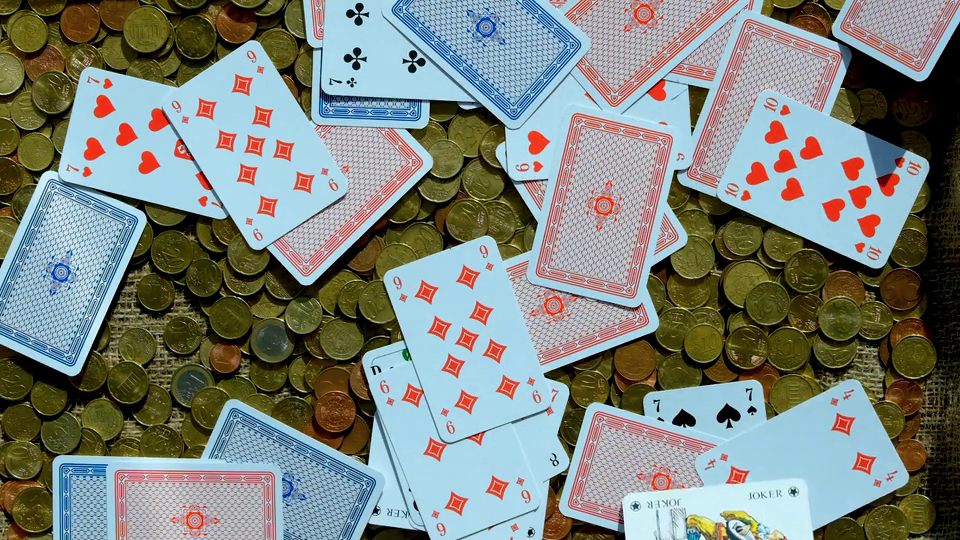


0: 384x640 (no detections), 13.2ms
Speed: 3.4ms preprocess, 13.2ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 11.7ms
Speed: 5.0ms preprocess, 11.7ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 12.9ms
Speed: 3.2ms preprocess, 12.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 11.2ms
Speed: 4.6ms preprocess, 11.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 12.3ms
Speed: 2.9ms preprocess, 12.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 12.3ms
Speed: 3.0ms preprocess, 12.3ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 12.1ms
Speed: 3.4ms preprocess, 12.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 15.1ms
Speed: 3.0ms preprocess, 15.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0

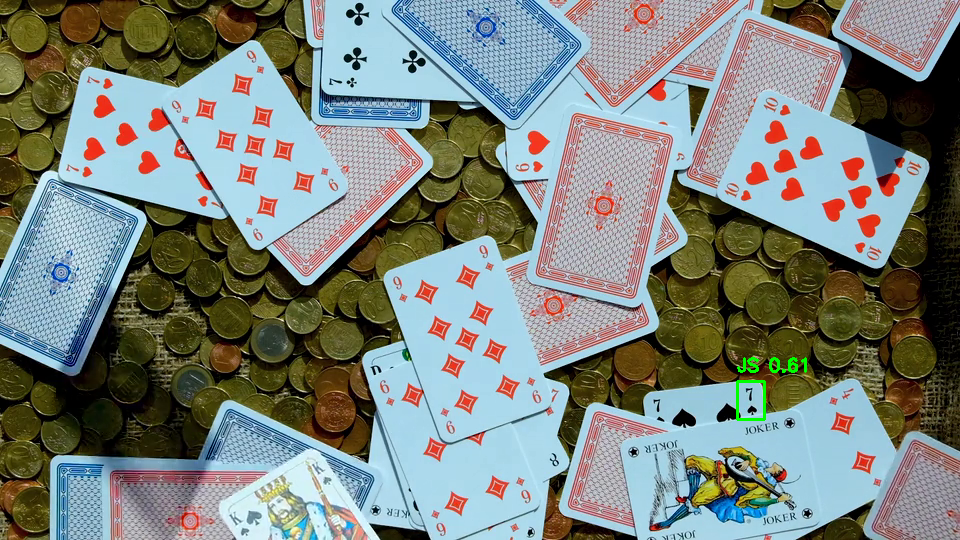


0: 384x640 1 JS, 13.3ms
Speed: 3.7ms preprocess, 13.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 10.8ms
Speed: 2.9ms preprocess, 10.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 10.9ms
Speed: 3.0ms preprocess, 10.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 11.2ms
Speed: 4.7ms preprocess, 11.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 10.8ms
Speed: 2.6ms preprocess, 10.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 10.8ms
Speed: 3.1ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 10.8ms
Speed: 3.1ms preprocess, 10.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 16.5ms
Speed: 3.8ms preprocess, 16.5ms inference, 3.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 15.0ms

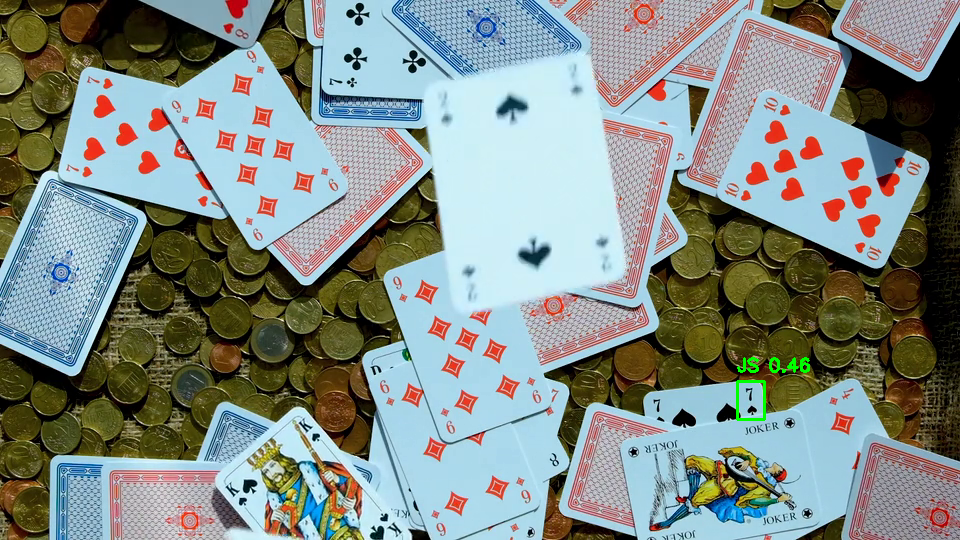


0: 384x640 1 JS, 11.1ms
Speed: 2.9ms preprocess, 11.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 10.8ms
Speed: 3.3ms preprocess, 10.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 10.8ms
Speed: 2.8ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 10.8ms
Speed: 2.6ms preprocess, 10.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 10.8ms
Speed: 2.6ms preprocess, 10.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 15.5ms
Speed: 4.3ms preprocess, 15.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 12.6ms
Speed: 3.0ms preprocess, 12.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 12.3ms
Speed: 3.8ms preprocess, 12.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 JS, 10.8ms

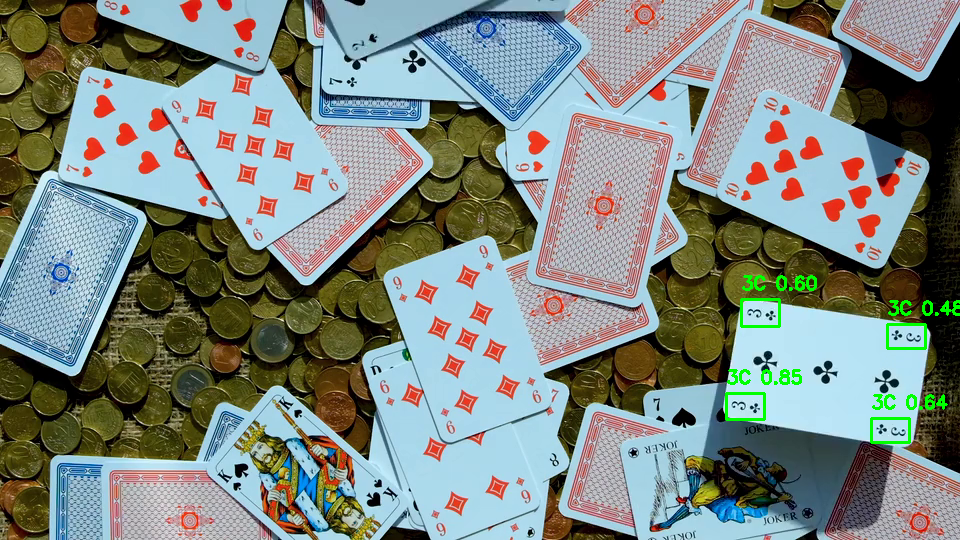


0: 384x640 3 3Cs, 1 AC, 10.8ms
Speed: 3.6ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.8ms
Speed: 2.8ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.8ms
Speed: 2.8ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 11.3ms
Speed: 3.2ms preprocess, 11.3ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 12.5ms
Speed: 2.8ms preprocess, 12.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.8ms
Speed: 4.4ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 2C, 3 3Cs, 12.8ms
Speed: 4.4ms preprocess, 12.8ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 11.0ms
Speed: 7.1ms preprocess, 11.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 

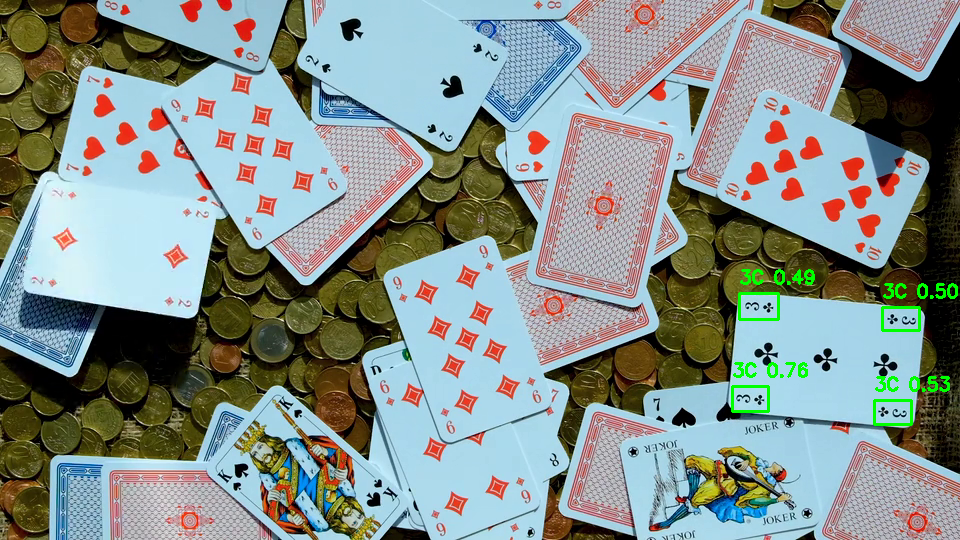


0: 384x640 4 3Cs, 10.9ms
Speed: 3.7ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.9ms
Speed: 3.4ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.8ms
Speed: 4.1ms preprocess, 10.8ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.8ms
Speed: 2.8ms preprocess, 10.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.8ms
Speed: 3.5ms preprocess, 10.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 13.3ms
Speed: 4.7ms preprocess, 13.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 13.2ms
Speed: 4.1ms preprocess, 13.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 11.9ms
Speed: 3.8ms preprocess, 11.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3C

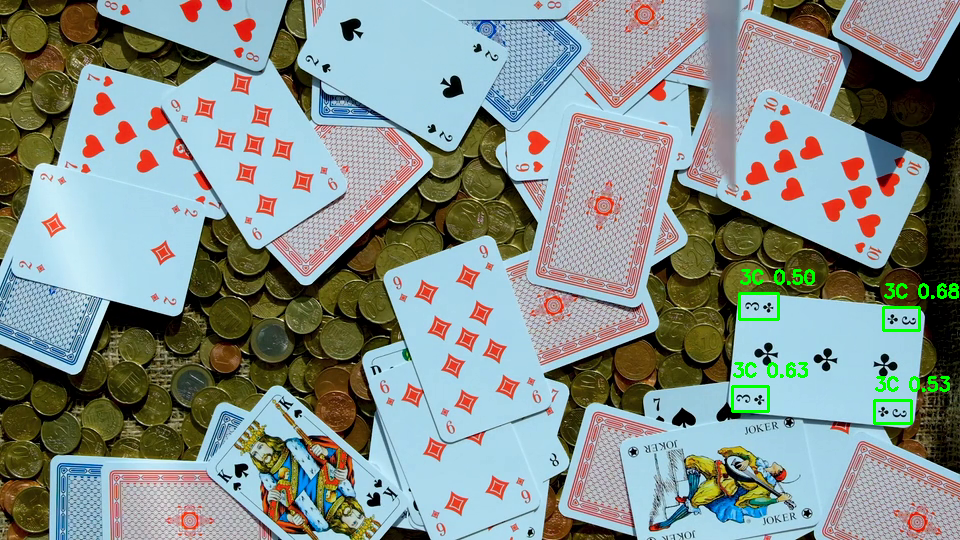


0: 384x640 4 3Cs, 11.8ms
Speed: 4.0ms preprocess, 11.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.9ms
Speed: 5.7ms preprocess, 10.9ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.8ms
Speed: 3.2ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.8ms
Speed: 2.8ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9C, 14.0ms
Speed: 2.9ms preprocess, 14.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 10.8ms
Speed: 3.2ms preprocess, 10.8ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 14.3ms
Speed: 5.1ms preprocess, 14.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 10.9ms
Speed: 3.7ms preprocess, 10.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x64

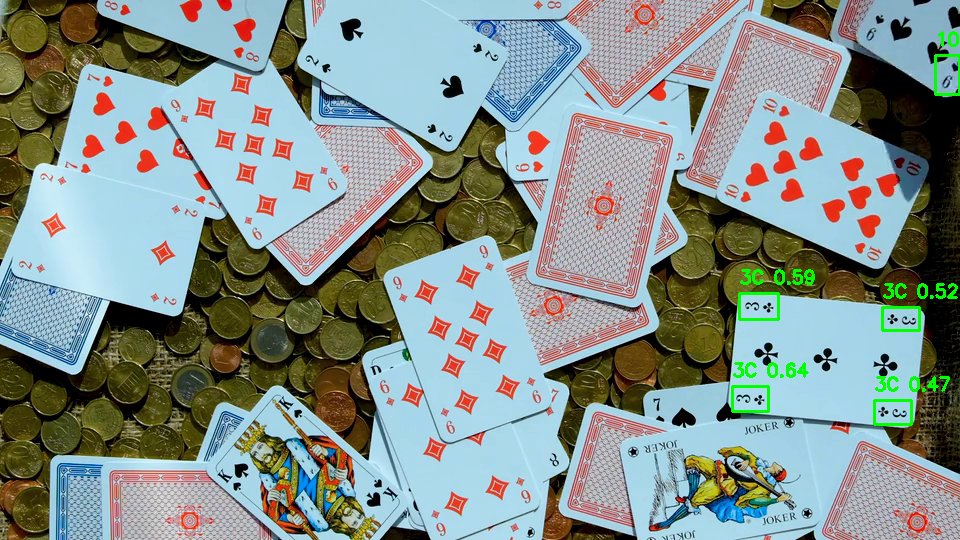


0: 384x640 1 10S, 4 3Cs, 2 9Ss, 11.0ms
Speed: 2.8ms preprocess, 11.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 10Ss, 4 3Cs, 1 9S, 14.4ms
Speed: 3.1ms preprocess, 14.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 13.2ms
Speed: 4.0ms preprocess, 13.2ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 14.7ms
Speed: 3.9ms preprocess, 14.7ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 12.6ms
Speed: 2.9ms preprocess, 12.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 11.3ms
Speed: 3.9ms preprocess, 11.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 10S, 4 3Cs, 1 9S, 10.8ms
Speed: 4.6ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 2 QSs, 11.0ms
Speed: 3.0ms preprocess, 11.0ms inf

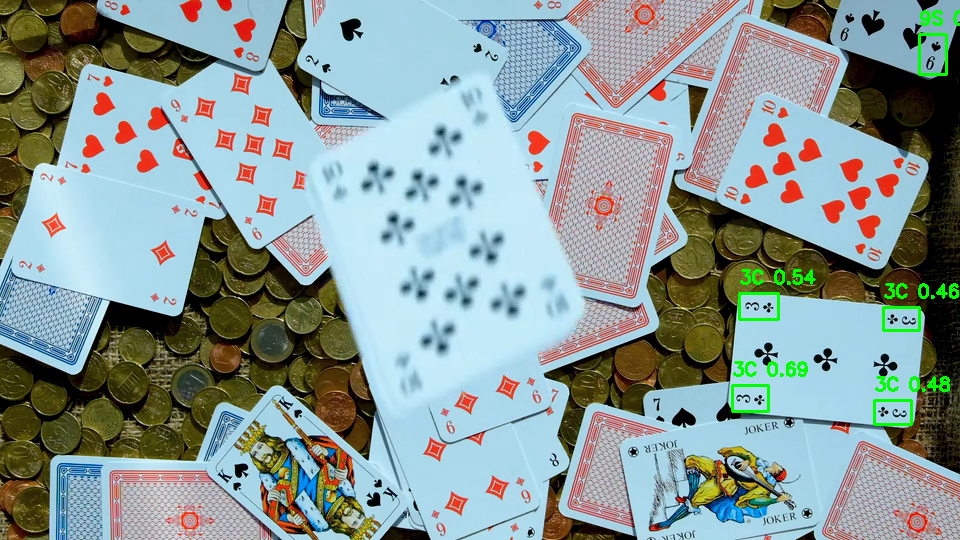


0: 384x640 4 3Cs, 1 9S, 11.4ms
Speed: 4.2ms preprocess, 11.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 12.4ms
Speed: 4.9ms preprocess, 12.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 11.3ms
Speed: 2.7ms preprocess, 11.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 11.1ms
Speed: 2.9ms preprocess, 11.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 14.3ms
Speed: 2.9ms preprocess, 14.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 10.8ms
Speed: 2.6ms preprocess, 10.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 10.8ms
Speed: 4.8ms preprocess, 10.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 11.4ms
Speed: 2.5ms preprocess, 11.4ms inference, 2.4ms postprocess per 

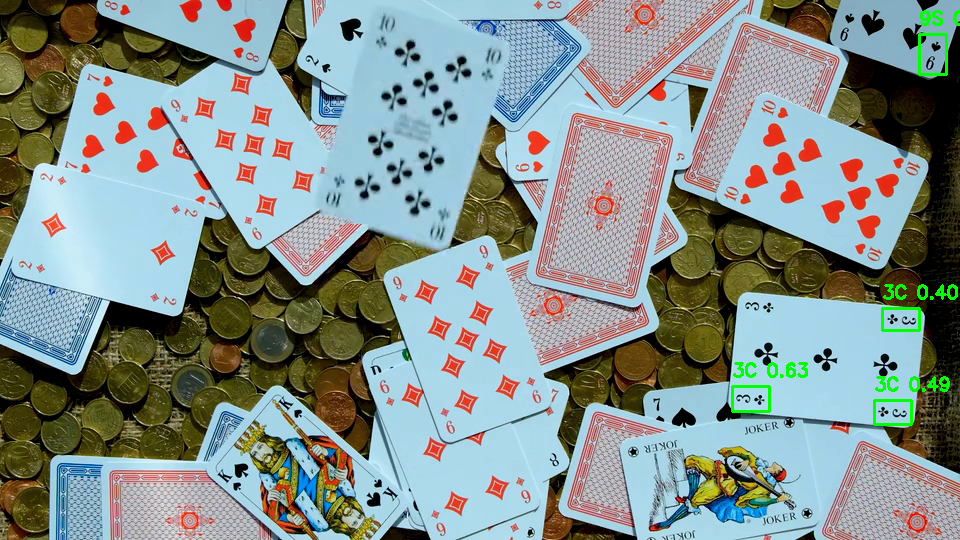


0: 384x640 3 3Cs, 1 9S, 1 AC, 12.4ms
Speed: 3.1ms preprocess, 12.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 9S, 10.8ms
Speed: 5.2ms preprocess, 10.8ms inference, 3.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 9S, 1 AC, 10.9ms
Speed: 2.6ms preprocess, 10.9ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 9S, 1 AC, 10.8ms
Speed: 3.8ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 9S, 1 AC, 10.8ms
Speed: 3.0ms preprocess, 10.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 9S, 1 AC, 10.8ms
Speed: 3.0ms preprocess, 10.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 9S, 1 AC, 10.8ms
Speed: 2.8ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 9S, 1 AC, 10.8ms
Speed: 2.6ms preprocess

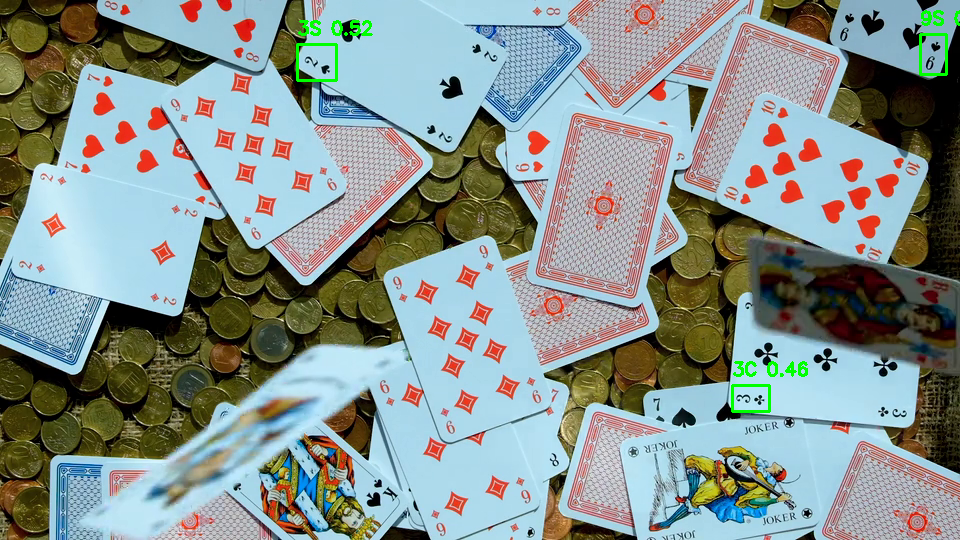


0: 384x640 2 3Cs, 1 3S, 1 9S, 10.9ms
Speed: 3.8ms preprocess, 10.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 3S, 1 9S, 11.6ms
Speed: 4.4ms preprocess, 11.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 3Cs, 1 9S, 10.8ms
Speed: 3.2ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 9S, 11.2ms
Speed: 4.7ms preprocess, 11.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 3C, 1 9S, 10.9ms
Speed: 4.3ms preprocess, 10.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 9S, 10.8ms
Speed: 3.5ms preprocess, 10.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 3C, 1 9S, 10.8ms
Speed: 3.3ms preprocess, 10.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 3C, 1 9S, 10.8ms
Speed: 3.5ms preprocess, 10.8ms inference, 1.6ms postprocess pe

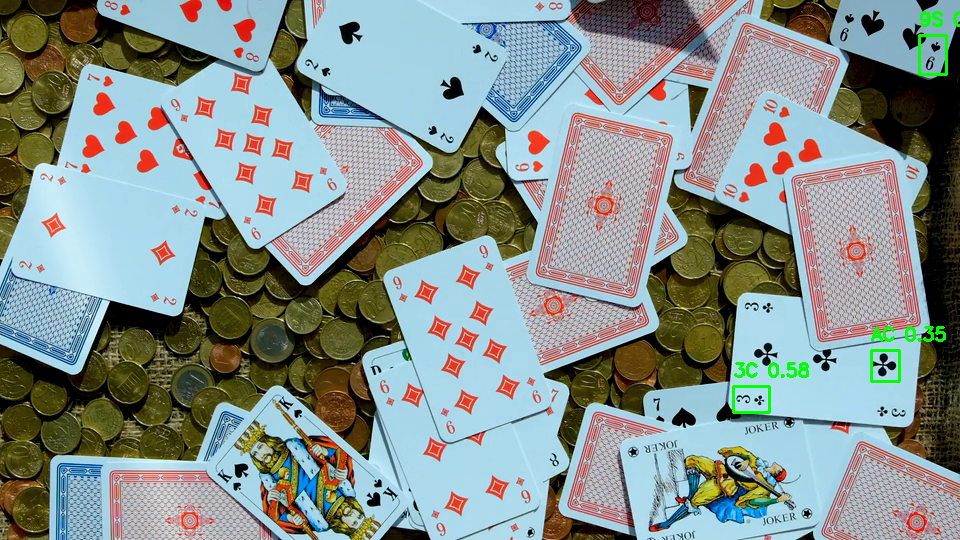


0: 384x640 1 3C, 1 9S, 10.8ms
Speed: 4.8ms preprocess, 10.8ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 3C, 1 9S, 14.5ms
Speed: 6.1ms preprocess, 14.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 3C, 1 9S, 17.2ms
Speed: 9.9ms preprocess, 17.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 3C, 1 9S, 17.8ms
Speed: 5.5ms preprocess, 17.8ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 3C, 1 9S, 14.2ms
Speed: 2.7ms preprocess, 14.2ms inference, 3.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 12.6ms
Speed: 3.8ms preprocess, 12.6ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 13.8ms
Speed: 3.8ms preprocess, 13.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 10.9ms
Speed: 3.0ms preprocess, 10.9ms inference, 1.6ms postprocess per image

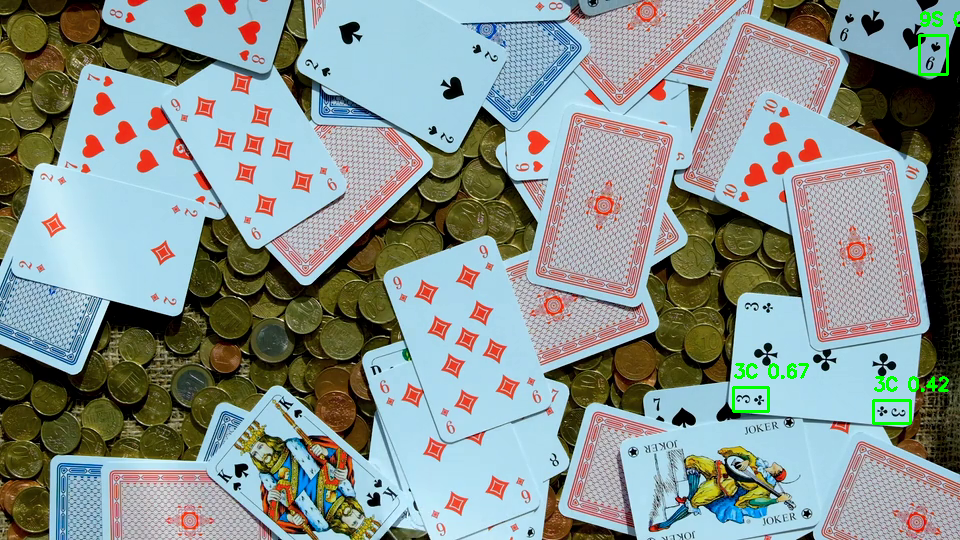


0: 384x640 2 3Cs, 1 9S, 11.9ms
Speed: 3.0ms preprocess, 11.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 11.2ms
Speed: 4.5ms preprocess, 11.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 12.2ms
Speed: 3.4ms preprocess, 12.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 12.9ms
Speed: 2.7ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 11.2ms
Speed: 3.1ms preprocess, 11.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 10.9ms
Speed: 3.9ms preprocess, 10.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 10.8ms
Speed: 2.8ms preprocess, 10.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 10.9ms
Speed: 2.9ms preprocess, 10.9ms inference, 1.6ms postprocess per 

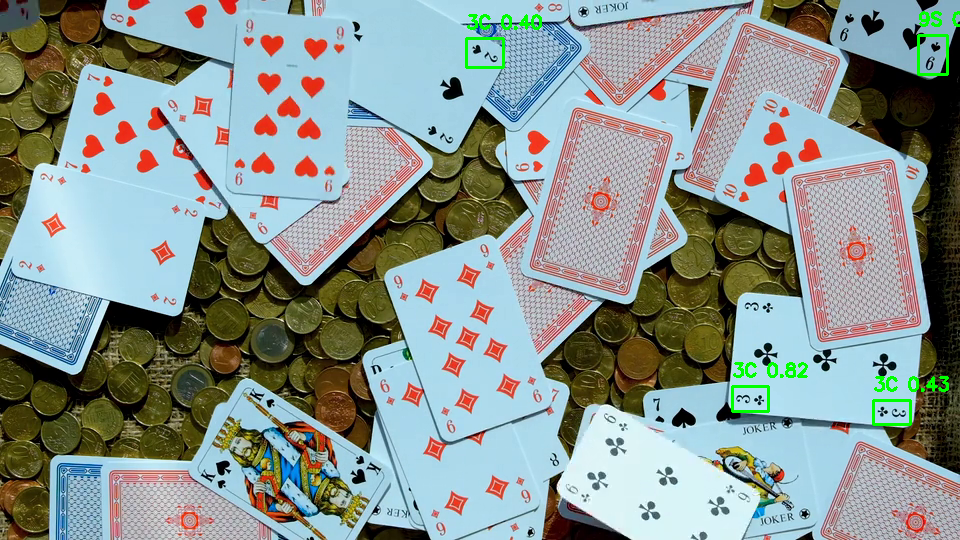


0: 384x640 1 10C, 2 3Cs, 1 9S, 11.2ms
Speed: 4.7ms preprocess, 11.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 12.9ms
Speed: 2.9ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 12.4ms
Speed: 3.9ms preprocess, 12.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 9C, 1 9S, 13.6ms
Speed: 2.8ms preprocess, 13.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 9S, 14.7ms
Speed: 4.4ms preprocess, 14.7ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9S, 13.9ms
Speed: 5.7ms preprocess, 13.9ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 3Cs, 1 4C, 1 6C, 1 9S, 11.9ms
Speed: 4.9ms preprocess, 11.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 10C, 3 3Cs, 1 4C, 1 9S, 11.0ms
Speed: 4.7ms preprocess, 11

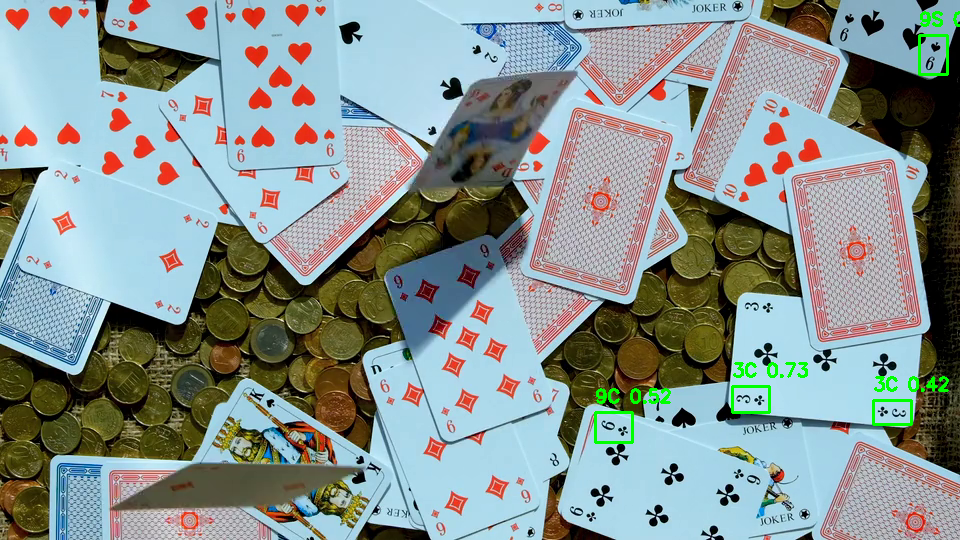


0: 384x640 2 3Cs, 1 9C, 1 9S, 11.9ms
Speed: 3.8ms preprocess, 11.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9C, 1 9S, 12.8ms
Speed: 3.2ms preprocess, 12.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9C, 1 9S, 12.9ms
Speed: 3.1ms preprocess, 12.9ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9C, 1 9S, 1 QS, 13.5ms
Speed: 2.7ms preprocess, 13.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9C, 1 9S, 1 QS, 14.9ms
Speed: 3.4ms preprocess, 14.9ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9C, 1 9S, 14.5ms
Speed: 4.8ms preprocess, 14.5ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9C, 1 9S, 14.3ms
Speed: 2.8ms preprocess, 14.3ms inference, 3.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 3Cs, 1 9C, 1 9S, 12.8ms
Speed

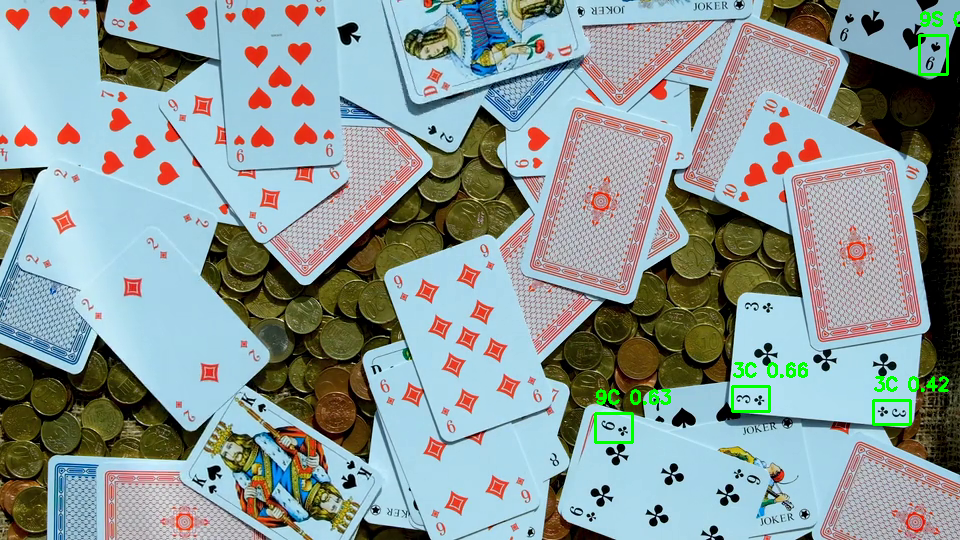

✅ วิดีโอบันทึกเสร็จที่ result.mp4


In [43]:
from google.colab.patches import cv2_imshow
import cv2
import os
import torch

def run_auto_input(file_path, model, output_path="output.mp4", conf_thres=0.35, iou_thres=0.45):
    video_exts = [".mp4", ".avi", ".mov", ".mkv"]
    image_exts = [".jpg", ".jpeg", ".png", ".bmp"]

    ext = os.path.splitext(file_path)[1].lower()

    def apply_nms(results, iou=0.45):
        """กรองกล่องที่ซ้อนกันด้วย torchvision NMS"""
        boxes = results[0].boxes
        if boxes is None or len(boxes) == 0:
            return boxes

        xyxy = boxes.xyxy.cpu()
        conf = boxes.conf.cpu()
        cls  = boxes.cls.cpu()

        keep = torch.ops.torchvision.nms(xyxy, conf, iou)
        return boxes[keep]

    if ext in video_exts:
        print("🎥 ตรวจพบว่าเป็นวิดีโอ")
        cap = cv2.VideoCapture(file_path)
        if not cap.isOpened():
            raise FileNotFoundError(f"Cannot open video at {file_path}")

        fps = int(cap.get(cv2.CAP_PROP_FPS))
        width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        fourcc = cv2.VideoWriter_fourcc(*"mp4v")
        out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

        frame_count = 0
        while True:
            ret, frame = cap.read()
            if not ret:
                break

            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            results = model(frame_rgb, conf=conf_thres, iou=iou_thres)

            # ✅ ใช้ NMS filter อีกชั้น
            filtered_boxes = apply_nms(results, iou=0.45)

            # ✅ วาดเฉพาะกล่องที่ผ่าน NMS
            annotated = frame.copy()
            if filtered_boxes is not None:
                for box in filtered_boxes:
                    x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
                    cls_id = int(box.cls[0].item())
                    conf = box.conf[0].item()
                    label = f"{model.names[cls_id]} {conf:.2f}"
                    cv2.rectangle(annotated, (x1, y1), (x2, y2), (0, 255, 0), 2)
                    cv2.putText(annotated, label, (x1, y1 - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

            out.write(annotated)

            if frame_count % 30 == 0:
                cv2_imshow(annotated)

            frame_count += 1

        cap.release()
        out.release()
        print(f"✅ วิดีโอบันทึกเสร็จที่ {output_path}")

    elif ext in image_exts:
        print("🖼️ ตรวจพบว่าเป็นภาพนิ่ง")
        image = cv2.imread(file_path)
        if image is None:
            raise FileNotFoundError(f"Image not found at {file_path}")

        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        results = model(image_rgb, conf=conf_thres, iou=iou_thres)

        filtered_boxes = apply_nms(results, iou=0.45)

        annotated = image.copy()
        if filtered_boxes is not None:
            for box in filtered_boxes:
                x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
                cls_id = int(box.cls[0].item())
                conf = box.conf[0].item()
                label = f"{model.names[cls_id]} {conf:.2f}"
                cv2.rectangle(annotated, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(annotated, label, (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

        cv2_imshow(annotated)
        save_path = "output.jpg"
        cv2.imwrite(save_path, annotated)
        print(f"✅ ภาพถูกบันทึกที่ {save_path}")

    else:
        raise ValueError("Unsupported file format!")

# ตัวอย่างการเรียกใช้
file_path = "/content/91678-629172618_small.mp4"
run_auto_input(file_path, model, output_path="result.mp4")


In [41]:
print(model.names)

{0: '10C', 1: '10D', 2: '10H', 3: '10S', 4: '2C', 5: '2D', 6: '2H', 7: '2S', 8: '3C', 9: '3D', 10: '3H', 11: '3S', 12: '4C', 13: '4D', 14: '4H', 15: '4S', 16: '5C', 17: '5D', 18: '5H', 19: '5S', 20: '6C', 21: '6D', 22: '6H', 23: '6S', 24: '7C', 25: '7D', 26: '7H', 27: '7S', 28: '8C', 29: '8D', 30: '8H', 31: '8S', 32: '9C', 33: '9D', 34: '9H', 35: '9S', 36: 'AC', 37: 'AD', 38: 'AH', 39: 'AS', 40: 'JC', 41: 'JD', 42: 'JH', 43: 'JS', 44: 'KC', 45: 'KD', 46: 'KH', 47: 'KS', 48: 'QC', 49: 'QD', 50: 'QH', 51: 'QS'}


In [33]:
#print(model.model)   # โครงสร้างเป็น layer ของ PyTorch